# Creation des Figures du rapport de visualisation

## Importation des principales librairies et du jeux de donnees

In [1]:
%config Completer.use_jedi = False

# Je narrivait pas a installer la librairy textBlob depuis la UI Anaconda
# Les 3 lignes ci-dessous sont a faire tourner une seule fois:

#import sys
#!{sys.executable} -m pip install textblob
#!{sys.executable} -m pip install textblob_fr


import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

fileName = 'df_complet.xlsx'
pathName = './Data'


# df=pd.read_excel(f'{pathName}\{fileName}')
df=pd.read_excel(f'{pathName}\{fileName}')



### Data Exploration

In [2]:
print((df.isnull() | df.isna()).mean() * 100)
pays_mode = df.Pays.value_counts();
print(pays_mode.index.tolist())

entreprise_mode = df.Entreprise.value_counts();
print(entreprise_mode.index.tolist())

Unnamed: 0             0.000000
Client                 0.007692
Nombre_avis_publie     0.000000
Note                   0.000000
Titres                 0.015734
Commentaire           18.737063
Date_experience        0.000000
Date_publication       0.000000
Reponse               79.546154
Date_reponse          79.546154
Pays                   0.000000
Verifications          0.000000
Entreprise             0.000000
dtype: float64
['FR', 'CH', 'US', 'GB', 'BE', 'DE', 'LU', 'ES', 'RE', 'IT', 'MQ', 'GP', 'NL', 'MC', 'PT', 'MA', 'SE', 'TN', 'CA', 'GF', 'RO', 'TR', 'TH', 'NC', 'DZ', 'GR', 'IE', 'CZ', 'SN', 'AT', 'PF', 'YT', 'AD', 'HU', 'MF', 'BG', 'PL', 'AE', 'MU', 'DK', 'CI', 'CN', 'FI', 'HR', 'SG', 'UA', 'AU', 'RU', 'JP', 'MX', 'SA', 'RS', 'HK', 'NO', 'IL', 'CO', 'DJ', 'CM', 'ID', 'MT', 'MG', 'CV', 'BL', 'KR', 'EG', 'MY', 'VN', 'IN', 'ZA', 'AR', 'SC', 'BR', 'EE', 'CL', 'TW', 'BA', 'KE', 'PK', 'GA', 'QA', 'MV', 'TG', 'DO', 'NG', 'ME', 'IS', 'BS', 'BJ', 'PM', 'KH', 'AL', 'SK', 'VG', 'LA', 'NZ'

1     107752
2      64551
3      38698
4      23895
5      15199
       ...  
82         1
75         1
62         1
61         1
97         1
Name: Nombre_avis_publie, Length: 68, dtype: int64


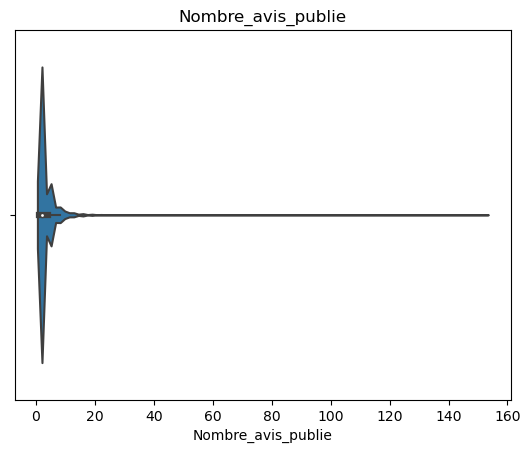

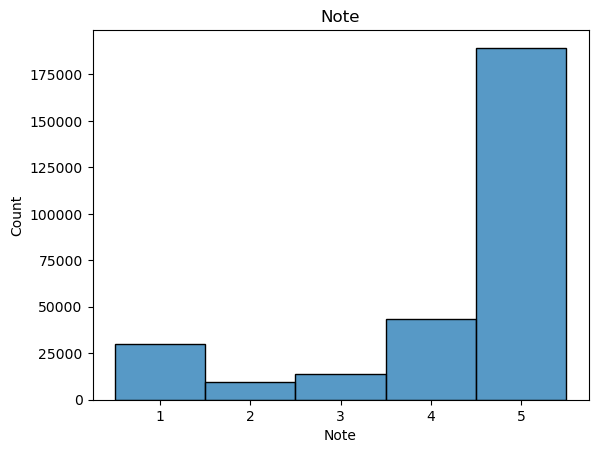

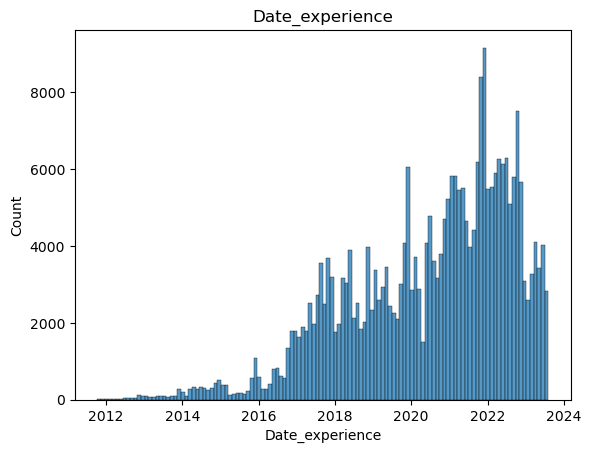

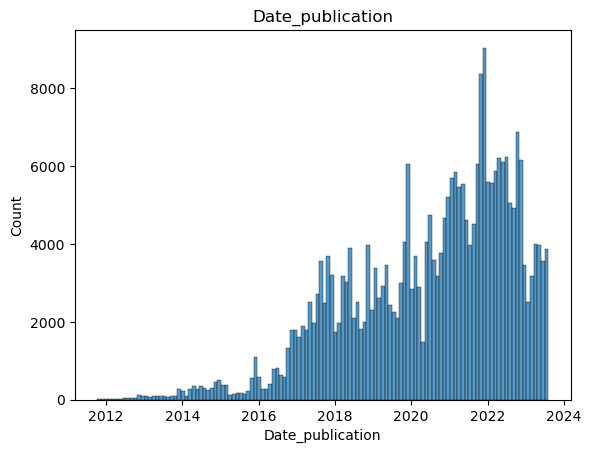

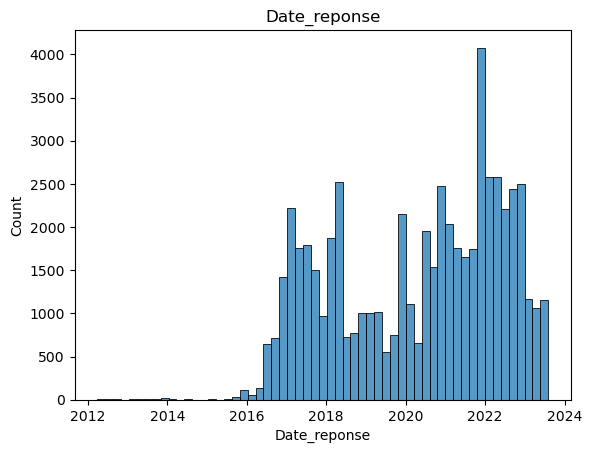

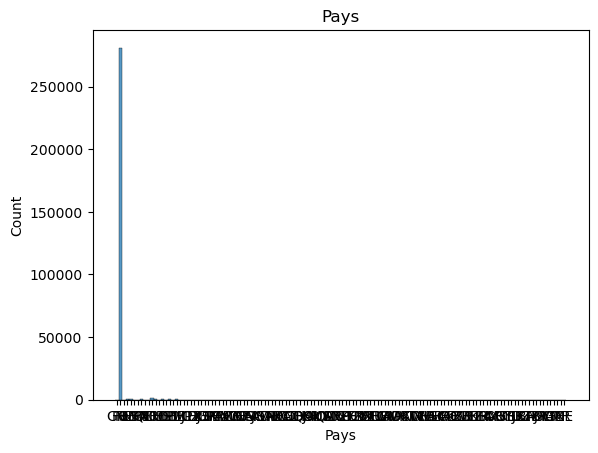

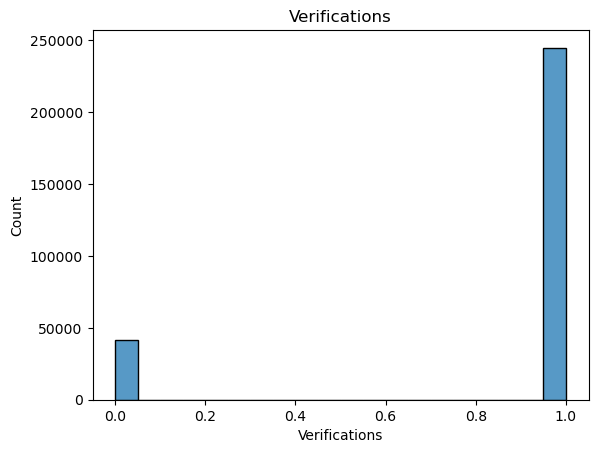

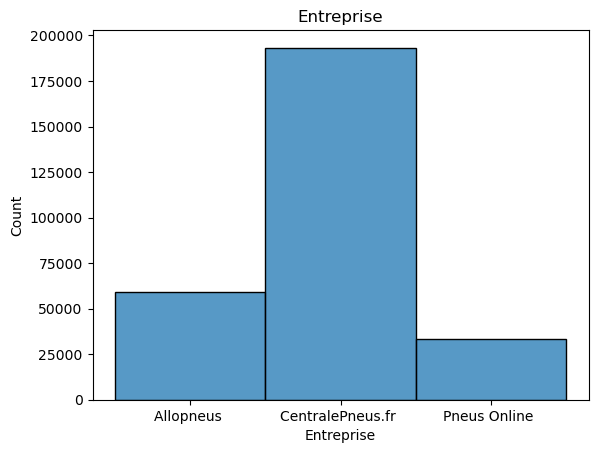

In [2]:
print(df.Nombre_avis_publie.value_counts())

fig001=sns.violinplot(data=df,x='Nombre_avis_publie')
plt.title('Nombre_avis_publie')
plt.show()
fig002=sns.histplot(data=df,x='Note',discrete=True)
plt.title('Note')
plt.show()
fig003=sns.histplot(data=df,x='Date_experience')
plt.title('Date_experience')
plt.show()
fig003=sns.histplot(data=df,x='Date_publication')
plt.title('Date_publication')
plt.show()
fig003=sns.histplot(data=df,x='Date_reponse')
plt.title('Date_reponse')
plt.show()
fig003=sns.histplot(data=df,x='Pays')
plt.title('Pays')
plt.show()
fig003=sns.histplot(data=df,x='Verifications')
plt.title('Verifications')
plt.show()
fig003=sns.histplot(data=df,x='Entreprise')
plt.title('Entreprise')
plt.show()

### Preprocessing

In [3]:
# Je supprime les lignes sans commentaires pour le moment:
df = df.dropna(subset='Commentaire')
df = df.drop(df[df['Commentaire'].isnull()].index)
df = df = df.drop_duplicates()
print(df.Titres.apply(lambda x: not(isinstance(x, str))).sum())
#df = df.drop(df.loc[df.Titres.apply(lambda x: not(isinstance(x, str)))].index)
print(df.columns)
df.reset_index()

print()

#df.Commentaire = df.Commentaire.str.lower()

63
Index(['Unnamed: 0', 'Client', 'Nombre_avis_publie', 'Note', 'Titres',
       'Commentaire', 'Date_experience', 'Date_publication', 'Reponse',
       'Date_reponse', 'Pays', 'Verifications', 'Entreprise'],
      dtype='object')



### Correlation:

In [4]:
from scipy.stats import pearsonr, chi2_contingency
print(df.columns)

catVar=['Nombre_avis_publie','Pays','Verifications','Entreprise','Date_experience','Date_publication','Note']
# catVar=['Nombre_avis_publie','Pays','Verifications','Entreprise','Date_experience','Date_publication','longCommentaire','longTitre','polarity','Note']
#catVar=['Nombre_avis_publie','Pays']

stat =[]
pval = []
dofs =[]
corr=[]

for col in catVar:
    stat_sub =[]
    pval_sub = []
    dofs_sub =[]
    corr_sub=[]
    for col2 in catVar:
        ct = pd.crosstab(df[col],df[col2])
        conting = chi2_contingency(ct)

        stat_sub.append(conting[0])
        pval_sub.append(conting[1])
        dofs_sub.append(conting[2])
        
        n=ct.sum().sum()
        corr_sub.append(np.sqrt(conting[0]/(len(df)*(min(ct.shape) - 1))))
        
    stat.append(stat_sub)
    pval.append(pval_sub)
    dofs.append(dofs_sub)
    corr.append(corr_sub)

    



# #Comparaison 2 var quantitative
# correl = pearsonr(df['Nombre_avis_publie'],df['Note'])
# print(correl)



# #Comparaison 2 variables qualitatives:
# ct = pd.crosstab(df['Date_experience'],df['Note'])

# conting = chi2_contingency(ct)

# print(f'Statistique du test {conting[0]}, p-value du test {conting[1]}')

Index(['Unnamed: 0', 'Client', 'Nombre_avis_publie', 'Note', 'Titres',
       'Commentaire', 'Date_experience', 'Date_publication', 'Reponse',
       'Date_reponse', 'Pays', 'Verifications', 'Entreprise'],
      dtype='object')


(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5]),
 [Text(0, 0.5, 'Nombre_avis_publie'),
  Text(0, 1.5, 'Pays'),
  Text(0, 2.5, 'Verifications'),
  Text(0, 3.5, 'Entreprise'),
  Text(0, 4.5, 'Date_experience'),
  Text(0, 5.5, 'Date_publication'),
  Text(0, 6.5, 'Note')])

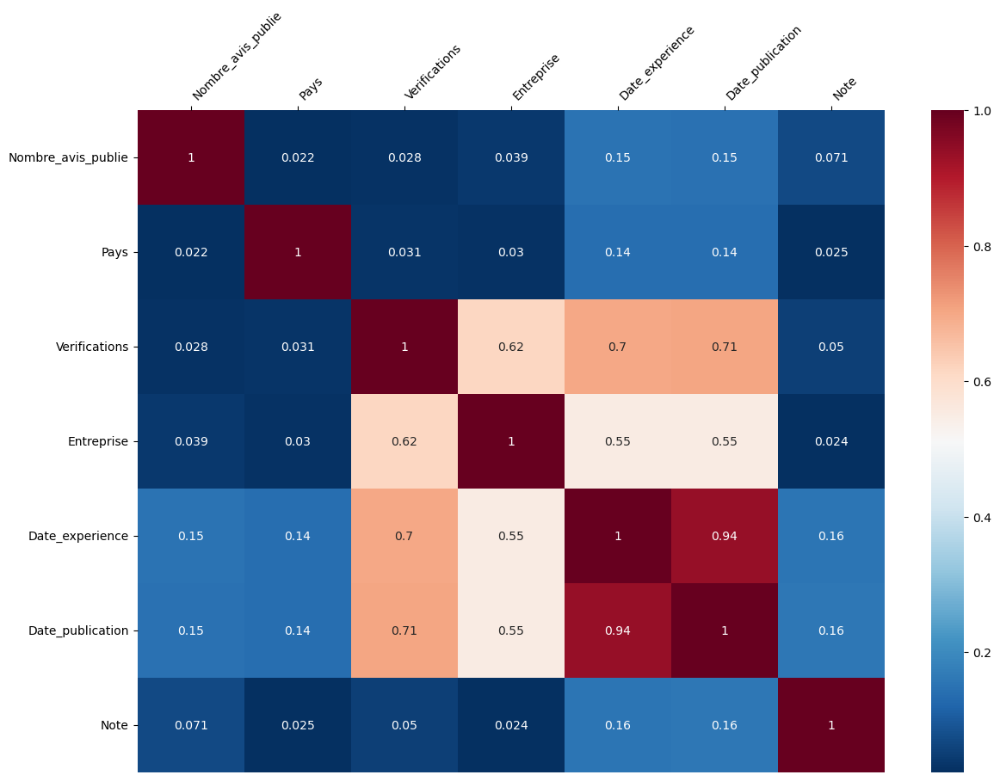

In [8]:

plt.figure(figsize=(14,10))
figcorr = sns.heatmap(np.array(corr),annot=True,cmap='RdBu_r')

figcorr.set_xticklabels(catVar)
figcorr.set_yticklabels(catVar)
figcorr.xaxis.tick_top()
plt.xticks(rotation=45)
plt.xticks(ha='left')
plt.yticks(rotation=0)

### Figure 1: Repartion des avis par note selon statut verifie

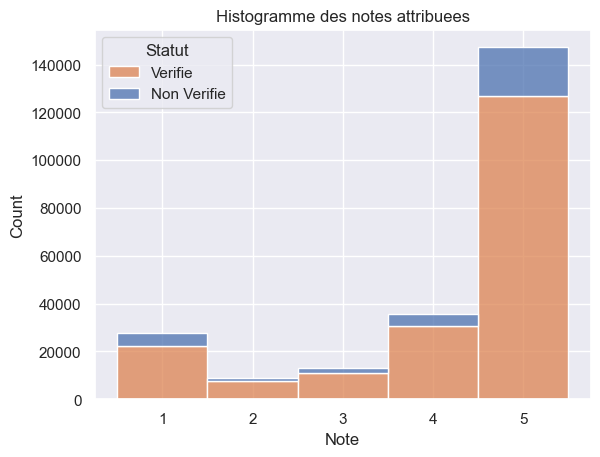

1    0.852744
0    0.147256
Name: Verifications, dtype: float64


In [7]:
sns.set_theme()
fig0 = sns.histplot(data=df,x='Note',hue='Verifications', multiple="stack",discrete=True)
fig0.set(title='Histogramme des notes attribuees')
plt.legend(title='Statut', loc='upper left', labels=['Verifie','Non Verifie'])
plt.show()

print(df.Verifications.value_counts(normalize=True))

Commentaire

### Figure 2: Repartition des Pays

In [8]:
print(df.Pays.value_counts(normalize=True))

FR    0.982333
CH    0.003795
US    0.001854
GB    0.001764
BE    0.001342
        ...   
NZ    0.000004
BB    0.000004
LB    0.000004
TT    0.000004
NE    0.000004
Name: Pays, Length: 123, dtype: float64


On remarque que les commentaires sont dorigines Francaises a 98%.
Les autres nationnalites ne sont donc pas representatives dans ce jeux de donnes.

### Figure 3: Notes categorise par le statut verifications

Index(['Unnamed: 0', 'Client', 'Nombre_avis_publie', 'Note', 'Titres',
       'Commentaire', 'Date_experience', 'Date_publication', 'Reponse',
       'Date_reponse', 'Pays', 'Verifications', 'Entreprise'],
      dtype='object')
False    0.769199
True     0.230801
Name: isResponse, dtype: float64


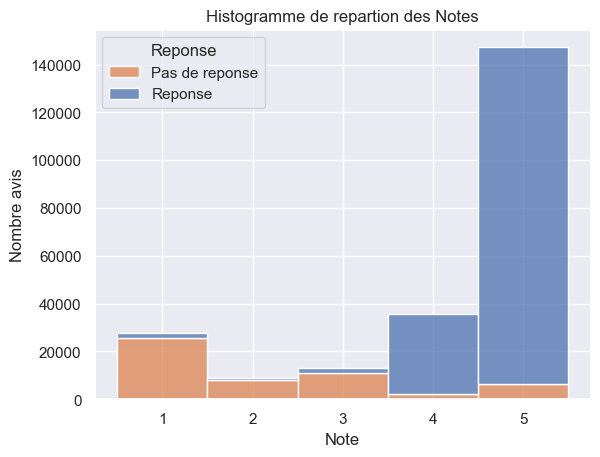

In [9]:
# Dans cette cellule je teste et compare les plots issues de plotly et seaborn
# Un seul des 2 plots sera conserve

print(df.columns)

df['iscommentaire'] = df.Commentaire.notna()
df['isResponse'] = df.Reponse.notna()

print(df.isResponse.value_counts(normalize=True))

fig3 = sns.histplot(data=df,x='Note',hue='isResponse', multiple="stack",discrete=True)


plt.legend(title='Reponse', loc='upper left', labels=['Pas de reponse', 'Reponse'])
plt.ylabel('Nombre avis')
plt.title('Histogramme de repartion des Notes')

plt.show()

### Plots sur Commentaires: longueurs

Index(['Unnamed: 0', 'Client', 'Nombre_avis_publie', 'Note', 'Titres',
       'Commentaire', 'Date_experience', 'Date_publication', 'Reponse',
       'Date_reponse', 'Pays', 'Verifications', 'Entreprise', 'iscommentaire',
       'isResponse'],
      dtype='object')
Outliers Limite bas = -91.0; Outliers Limite haut = 277.0
(277.0, -91.0)
Outliers Limite bas = -91.0; Outliers Limite haut = 277.0


Text(0.5, 1.0, 'Repartition des Avis en fonction du nombre de caracteres des Commentaires')

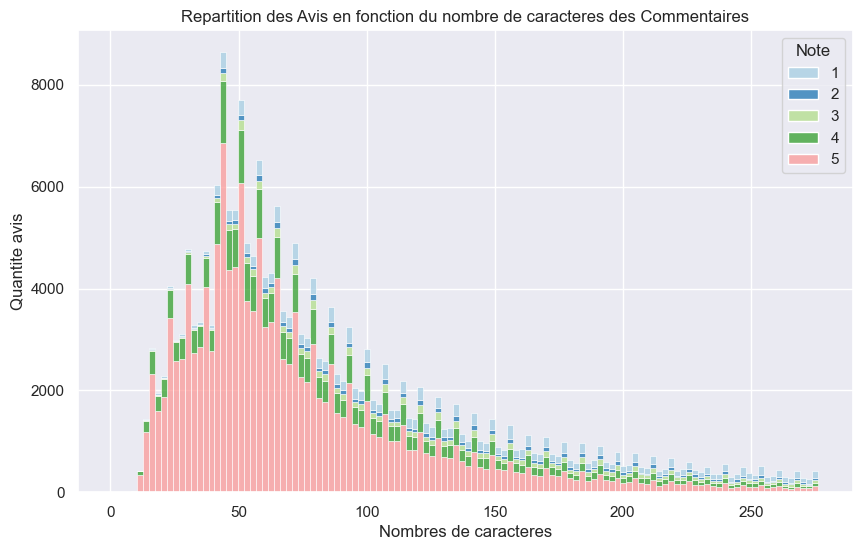

In [10]:
print(df.columns)
import numpy as np
def get_outliers(serie):
    outLimit_p = serie.quantile(.75) + 1.5*(serie.quantile(.75)-serie.quantile(.25));
    outLimit_n = serie.quantile(.25) - 1.5*(serie.quantile(.75)-serie.quantile(.25));
    print(f'Outliers Limite bas = {outLimit_n}; Outliers Limite haut = {outLimit_p}')
    return outLimit_p, outLimit_n

df.Commentaire = df.Commentaire.astype('str')
df['longCommentaire']  = df.Commentaire.apply(lambda x: len(x))
print(get_outliers(df.longCommentaire))

outLimit_p,outLimit_n  =get_outliers(df.longCommentaire)

sns.set_theme()

plt.figure(figsize=(10,6))
fig_comment1 = sns.histplot(palette=sns.color_palette('Paired',5),data=df[(df.longCommentaire<outLimit_p) & (df.longCommentaire>outLimit_n)],x='longCommentaire',hue='Note',multiple='stack')
fig_comment1.set_xlabel('Nombres de caracteres')
fig_comment1.set_ylabel('Quantite avis')
fig_comment1.set_title('Repartition des Avis en fonction du nombre de caracteres des Commentaires')

#sns.boxenplot(data=df[(df.longCommentaire<outLimit_p) & (df.longCommentaire>outLimit_n)], x='longCommentaire')

Index(['Unnamed: 0', 'Client', 'Nombre_avis_publie', 'Note', 'Titres',
       'Commentaire', 'Date_experience', 'Date_publication', 'Reponse',
       'Date_reponse', 'Pays', 'Verifications', 'Entreprise', 'iscommentaire',
       'isResponse', 'longCommentaire'],
      dtype='object')
Outliers Limite bas = -21.5; Outliers Limite haut = 70.5
(70.5, -21.5)
Outliers Limite bas = -21.5; Outliers Limite haut = 70.5


Text(0.5, 1.0, 'Repartition des Avis en fonction du nombre de caracteres des Titres')

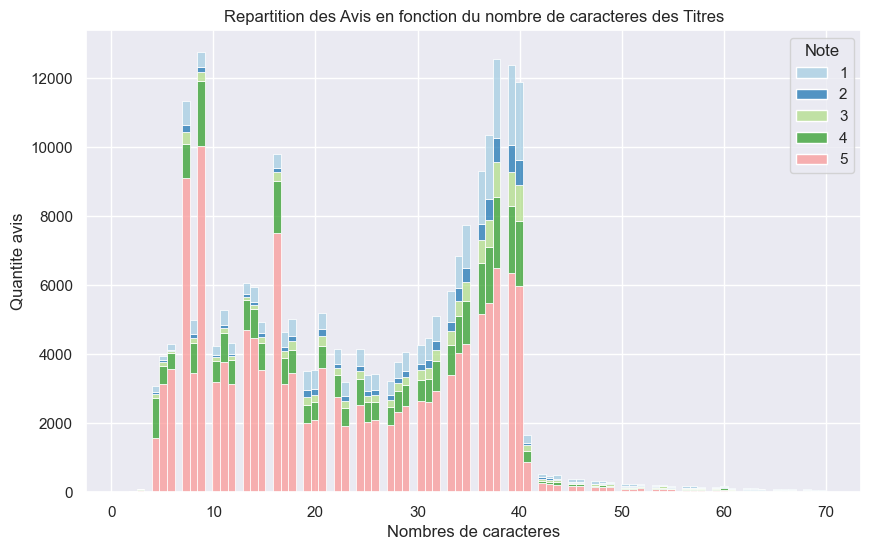

In [11]:
print(df.columns)
df.Titres = df.Titres.astype('str')
df['longTitre']  = df.Titres.apply(lambda x: len(x))

print(get_outliers(df.longTitre))

outLimit_p,outLimit_n  =get_outliers(df.longTitre)

sns.set_theme()

plt.figure(figsize=(10,6))
fig_titre1 = sns.histplot(palette=sns.color_palette("Paired", 5),data=df[(df.longTitre<outLimit_p) & (df.longTitre>outLimit_n)],x='longTitre',hue='Note',multiple='stack')
fig_titre1.set_xlabel('Nombres de caracteres')
fig_titre1.set_ylabel('Quantite avis')
fig_titre1.set_title('Repartition des Avis en fonction du nombre de caracteres des Titres')

#sns.boxenplot(data=df[(df.longCommentaire<outLimit_p) & (df.longCommentaire>outLimit_n)], x='longCommentaire')

### Plots sur commentaires: Uppercase, ponctuation, caractere speciaux

In [14]:
def Count_special(str):
    upper, lower, number, ponctuation, special = 0, 0, 0, 0, 0
    for i in range(len(str)):
        if str[i].isupper():
            upper += 1
        elif str[i].islower():
            lower += 1
        elif str[i].isdigit():
            number += 1
        elif str[i] in ['!','?']:
            ponctuation += 1
            
        elif str[i] in '@#$%&+=-<>~/\"*(){}[]':
            special += 1
#     print('Upper case letters:', upper)
#     print('Lower case letters:', lower)
#     print('Number:', number)
#     print('Ponctuation:', ponctuation)
#     print('Special characters:', special)
    
    return upper,lower,number,ponctuation,special

print(Count_special(df.Titres[0]))

df.head()
df['UpperCount'], _, df['digitCount'], df['PonctCount'],df['SpecialCount'] = zip(*df.Commentaire.apply(lambda x: Count_special(x)))

(1, 36, 0, 0, 0)


Outliers Limite bas = -2.0; Outliers Limite haut = 6.0
Outliers Limite bas = 0.0; Outliers Limite haut = 0.0
Outliers Limite bas = 0.0; Outliers Limite haut = 0.0
Outliers Limite bas = 0.0; Outliers Limite haut = 0.0


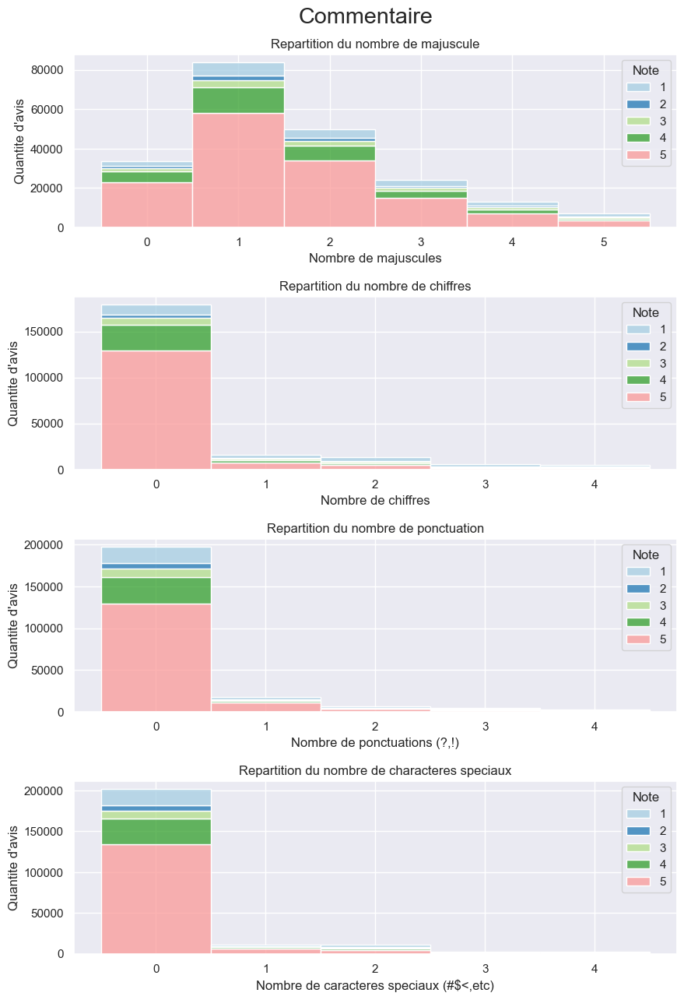

In [26]:
sns.set_theme()
f, (ax1, ax2,ax3, ax4) = plt.subplots(4, 1,figsize=(10, 15))
f.suptitle('Commentaire',y=0.92,fontsize='xx-large')

#Plot Majuscules:
out_p,out_n = get_outliers(df.UpperCount)
fig001 = sns.histplot(data = df[(df.UpperCount<np.maximum(5,out_p))], x='UpperCount',ax=ax1,discrete=True,hue='Note',palette=sns.color_palette("Paired", 5),multiple='stack')
fig001.set(title='Repartition du nombre de majuscule')
fig001.set_xlabel('Nombre de majuscules')
fig001.set_ylabel('Quantite d\'avis')


#Plot Majuscules:
out_p,out_n = get_outliers(df.digitCount)
fig002 = sns.histplot(data = df[(df.digitCount<np.maximum(5,out_p))], x='digitCount',ax=ax2,discrete=True,hue='Note',palette=sns.color_palette("Paired", 5),multiple='stack')
fig002.set(title='Repartition du nombre de chiffres')
fig002.set_xlabel('Nombre de chiffres')
fig002.set_ylabel('Quantite d\'avis')

#Plot Majuscules:
out_p,out_n = get_outliers(df.PonctCount)
fig003 = sns.histplot(data = df[(df.PonctCount<np.maximum(5,out_p)) ], x='PonctCount',ax=ax3,discrete=True,hue='Note',palette=sns.color_palette("Paired", 5),multiple='stack')
fig003.set(title='Repartition du nombre de ponctuation')
fig003.set_xlabel('Nombre de ponctuations (?,!)')
fig003.set_ylabel('Quantite d\'avis')

#Plot Majuscules:
out_p,out_n = get_outliers(df.SpecialCount)
fig004 = sns.histplot(data = df[(df.SpecialCount<np.maximum(5,out_p))], x='SpecialCount',ax=ax4,discrete=True,hue='Note',palette=sns.color_palette("Paired", 5),multiple='stack')
fig004.set(title='Repartition du nombre de characteres speciaux')
fig004.set_xlabel('Nombre de caracteres speciaux (#$<,etc)')
fig004.set_ylabel('Quantite d\'avis')


f.subplots_adjust(hspace=0.4)

### Figure 4: Mots les plus present

Creation de la fonction get_top_ngram extrait les mots ou groupes de mots les plus recurrents d'une serie de strings. Dns notre cas corpus peut etre egale a la colonne Commentaire, title ou reponse

In [27]:
from sklearn.feature_extraction.text import CountVectorizer

def get_top_ngram(corpus, n=None, ngrame=1,stopWord=True):
    """
    Compte le nombre de recurrences des ngrames presents dans le corpus et retourne le top n ngrames et leur decomptes.

    :param corpus: Serie, incluant 1 seul colonne de string
    :param n: int, Nombre de Ngrame a collecter apres triage
    :param ngrame: int, ordre du Ngrame vise. 1 mot = 1grame, couple mots se suivant = 2grame, etc
    :param stopWord: Boolean, filtre les stopWord present dans les string. La list de stop word est definie dans la
    fonction. StopWord example = le,la,les,de,je,etc
    :return: List of tuple, [(mot,nombre recense)]
    """

    items = {"ä": "a", "ç": "c", "è": "e", "º": "", "Ã": "A", "Í": "I", "í": "i", "Ü": "U", "â": "a", "ò": "o", "¿": "",
             "ó": "o", "á": "a", "à": "a", "õ": "o", "¡": "", "Ó": "O", "ù": "u", "Ú": "U", "´": "", "Ñ": "N", "Ò": "O",
             "ï": "i", "Ï": "I", "Ç": "C", "À": "A", "É": "E", "ë": "e", "Á": "A", "ã": "a", "Ö": "O", "ú": "u",
             "ñ": "n", "é": "e", "ê": "e", "·": "-", "ª": "a", "°": "", "ü": "u", "ô": "o","+":"plus","-":"moins","_":" "}

    stopWordFrench = ['alors','au','ai','aucuns','aussi','autre','avant','avec','avoir','bon','car','ce','cela',
                      'ces','ceux','chaque','ci','comme','comment','dans','de','des','du','dedans','dehors','depuis',
                      'devrait','doit','donc','dos','debut','elle','elles','en','encore','essai','est','et','eu',
                      'fait','faites','fois','font','hors','ici','il','ils','je','juste','la','le','les','leur','ma',
                      'maintenant','mais','mes','mien','moins','mon','mot','meme','ni','nommes','notre','nous','ou',
                      'par','parce','peut','plupart','pour','pourquoi','quand','que','quel','quelle','quelles',
                      'quels','qui','sa','sans','ses','seulement','si','sien','son','sont','sous','soyez','sujet',
                      'sur','ta','un','une','tandis','tellement','tels','tes','ton','tous','tout','tres','tu',
                      'voient','vont','votre','vous','vu','ca','etaient','etat','etions','ete','etre','me','chez',
                      'on','ont',"de_","et_","la_","le_","j_ai","j_"]

    stopWord = stopWordFrench if stopWord else None

    corpus = corpus.str.replace(r'[^\x00-\x7F]', lambda x: items.get(x.group(0)) or '_', regex=True)

    vec = CountVectorizer(ngram_range=(ngrame, ngrame), stop_words=stopWord).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    
    return words_freq[:n]


Recuperation des 20 mots les plus recurrents:

pas 38667
pneus 31806
commande 25027
ne 17938
livraison 14559
 pas pneus commande ne livraison


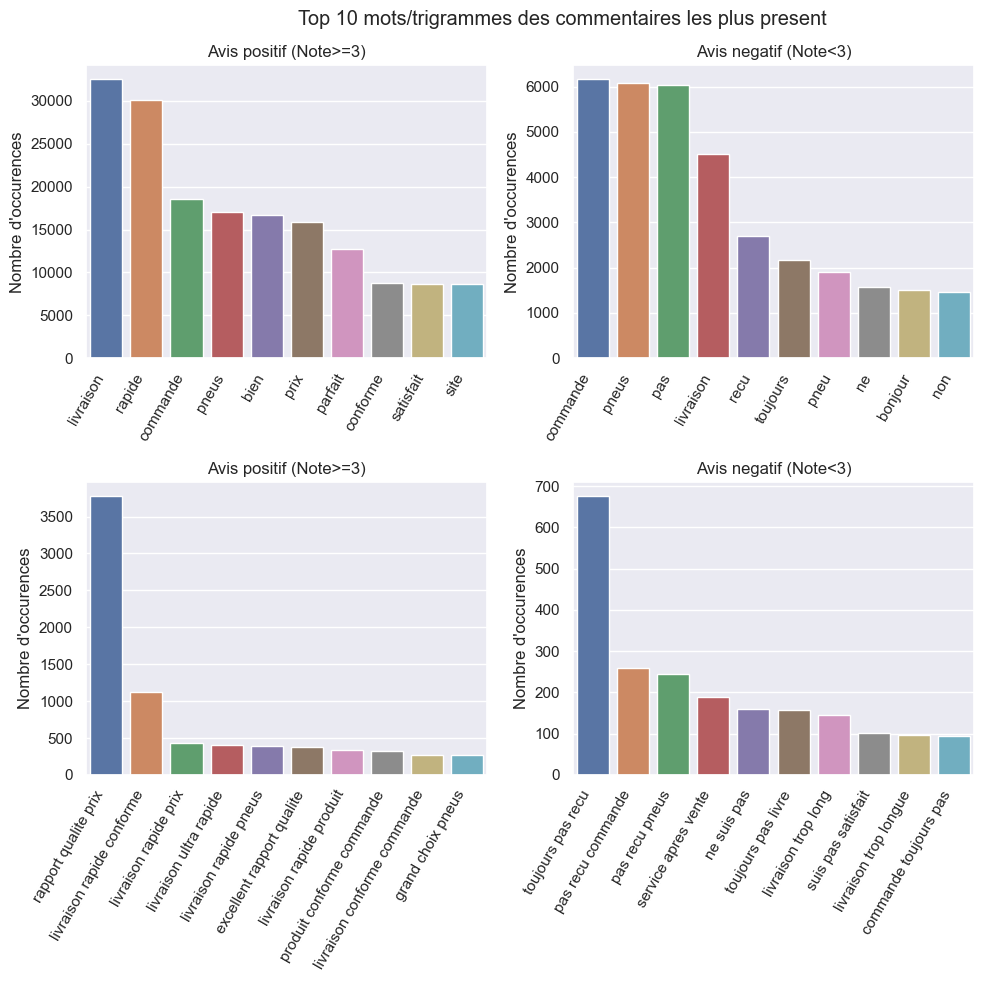

In [28]:
common_words = get_top_ngram(df.loc[df.Note<3]['Commentaire'].dropna().astype(str), n=5,ngrame=1,stopWord=True)
textCloud=''
for word, freq in common_words:
    textCloud += ' ' + word 
    print(word, freq)

print(textCloud)    
    
df_commonWord = pd.DataFrame(common_words,columns=['mots','count'])

# sns.set_style("whitegrid")
sns.set_theme()

ngrameNB=1
f, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2,figsize=(10, 10))
f.suptitle('Top 10 mots/trigrammes des commentaires les plus present',x=0.57)
common_words1 = get_top_ngram(df.loc[df.Note>=3]['Titres'].dropna().astype(str), n=10,ngrame=ngrameNB,stopWord=True)
df_commonWord1 = pd.DataFrame(common_words1,columns=['mots','count'])
fig4=sns.barplot(data = df_commonWord1,x='mots',y='count',ax=ax1)
fig4.set_xticklabels(fig4.get_xticklabels(),rotation=60,ha="right")
plt.tight_layout()
fig4.set(title='Avis positif (Note>=3)')
ax1.set_ylabel('Nombre d\'occurences')#.ylabel('Nombre d\'occurences')
ax1.set(xlabel=None)

common_words2 = get_top_ngram(df.loc[df.Note<3]['Titres'].dropna().astype(str), n=10,ngrame=ngrameNB,stopWord=True)
df_commonWord2 = pd.DataFrame(common_words2,columns=['mots','count'])
fig41=sns.barplot(data = df_commonWord2,x='mots',y='count',ax=ax2)
fig41.set_xticklabels(fig41.get_xticklabels(),rotation=60,ha="right")
plt.tight_layout()
fig41.set(title='Avis negatif (Note<3)')
ax2.set_ylabel('Nombre d\'occurences')#plt.ylabel('Nombre d\'occurences')
ax2.set(xlabel=None)

ngrameNB=3
common_words3 = get_top_ngram(df.loc[df.Note>=3]['Titres'].dropna().astype(str), n=10,ngrame=ngrameNB,stopWord=True)
df_commonWord3 = pd.DataFrame(common_words3,columns=['mots','count'])
fig42=sns.barplot(data = df_commonWord3,x='mots',y='count',ax=ax3)
fig42.set_xticklabels(fig42.get_xticklabels(),rotation=60,ha="right")
plt.tight_layout()
fig42.set(title='Avis positif (Note>=3)')
ax3.set_ylabel('Nombre d\'occurences')#.ylabel('Nombre d\'occurences')
ax3.set(xlabel=None)

common_words4 = get_top_ngram(df.loc[df.Note<3]['Titres'].dropna().astype(str), n=10,ngrame=ngrameNB,stopWord=True)
df_commonWord4 = pd.DataFrame(common_words4,columns=['mots','count'])
fig43=sns.barplot(data = df_commonWord4,x='mots',y='count',ax=ax4)
fig43.set_xticklabels(fig43.get_xticklabels(),rotation=60,ha="right")
plt.tight_layout()
fig43.set(title='Avis negatif (Note<3)')
ax4.set_ylabel('Nombre d\'occurences')#plt.ylabel('Nombre d\'occurences')
ax4.set(xlabel=None)

# fig4=sns.barplot(data = df_commonWord,x='mots',y='count')
# fig4.set_xticklabels(fig4.get_xticklabels(),rotation=60,ha="right")
# plt.tight_layout()
# fig4.set(title='Top 5 mots des commentaires associes a une note positive')

# plt.ylabel('Nombre d\'occurences')
plt.show()

### Figure 5: Joint plot Note + Sentiment

PreProcessing:

In [29]:
# Code:

from textblob import Blobber
from textblob_fr import PatternTagger, PatternAnalyzer

#print(df.loc[df.Commentaire.apply(lambda x: not(isinstance(x, str)))].head())
# df = df.drop(df.loc[df.Commentaire.apply(lambda x: not(isinstance(x, str)))].index)
# df.reset_index()
#df.info()

# Definit objet blobber et configure les modeles francais
tb = Blobber(pos_tagger=PatternTagger(), analyzer=PatternAnalyzer())

# Fonction nettoyant le text
def preprocess(ReviewText):
    ReviewText = ReviewText.str.replace("(<br/>)", "")
    ReviewText = ReviewText.str.replace('(<a).*(>).*(</a>)', '')
    ReviewText = ReviewText.str.replace('(&amp)', '')
    ReviewText = ReviewText.str.replace('(&gt)', '')
    ReviewText = ReviewText.str.replace('(&lt)', '')
    ReviewText = ReviewText.str.replace('(\xa0)', ' ')
    return ReviewText

# df['Commentaire'] = preprocess(df['Commentaire'])
# df['polarity'] = df['Commentaire'].map(lambda text: tb(text).sentiment[0])


df = df.drop(df.loc[df.Titres.apply(lambda x: not(isinstance(x, str)))].index)
df.reset_index()
df['Titres'] = preprocess(df['Titres'])
df['polarity'] = df['Commentaire'].map(lambda text: tb(text).sentiment[0])



C:\Users\joan\AppData\Local\Temp\ipykernel_3308\3047976830.py:16: FutureWarning: The default value of regex will change from True to False in a future version.
  ReviewText = ReviewText.str.replace("(<br/>)", "")
C:\Users\joan\AppData\Local\Temp\ipykernel_3308\3047976830.py:17: FutureWarning: The default value of regex will change from True to False in a future version.
  ReviewText = ReviewText.str.replace('(<a).*(>).*(</a>)', '')
C:\Users\joan\AppData\Local\Temp\ipykernel_3308\3047976830.py:18: FutureWarning: The default value of regex will change from True to False in a future version.
  ReviewText = ReviewText.str.replace('(&amp)', '')
C:\Users\joan\AppData\Local\Temp\ipykernel_3308\3047976830.py:19: FutureWarning: The default value of regex will change from True to False in a future version.
  ReviewText = ReviewText.str.replace('(&gt)', '')
C:\Users\joan\AppData\Local\Temp\ipykernel_3308\3047976830.py:20: FutureWarning: The default value of regex will change from True to False in

Plots:

In [33]:

trace1 = go.Scatter(
    x=df['polarity'], y=df['Note'], mode='markers', name='points',
    marker=dict(color='rgb(102,0,0)', size=2, opacity=0.4)
)
trace2 = go.Histogram2dContour(
    x=df['polarity'], y=df['Note'], name='density', ncontours=30,
    colorscale='Hot', reversescale=True, showscale=False
)
trace3 = go.Histogram(
    x=df['polarity'], name='Sentiment polarity density',nbinsx=110,
    marker=dict(color='rgb(102,0,0)'),
    yaxis='y2'
)
trace4 = go.Histogram(
    y=df['Note'], name='Rating density', marker=dict(color='rgb(102,0,0)'),
    xaxis='x2'
)
data = [trace1, trace2, trace3, trace4]

layout = go.Layout(
    showlegend=False,
    autosize=False,
    width=1200,
    height=700,
    xaxis=dict(
        domain=[0, 0.85],
        showgrid=True,
        zeroline=False
    ),
    yaxis=dict(
        domain=[0, 0.85],
        showgrid=True,
        zeroline=False
    ),
    margin=dict(
        t=50
    ),
    hovermode='closest',
    bargap=0,
    xaxis2=dict(
        domain=[0.85, 1],
        showgrid=True,
        zeroline=False
    ),
    yaxis2=dict(
        domain=[0.85, 1],
        showgrid=True,
        zeroline=False
    )
)

fig = go.Figure(data=data, layout=layout)
fig.update_layout(
    title={'text':"2D Density jointplot of Sentiment Polarity vs. Note",'xanchor':'center','yanchor':'top','x':0.5,'y':0.9},
    xaxis_title="Sentiment Polarity",
    yaxis_title="Note",
    margin=dict(t=100)
    )

fig.update_layout(
    plot_bgcolor='white'
)
fig.update_xaxes(
    mirror=True,
    ticks='outside',
    showline=True,
    linecolor='black',
    gridcolor='lightgrey'
)
fig.update_yaxes(
    mirror=True,
    ticks='outside',
    showline=True,
    linecolor='black',
    gridcolor='lightgrey'
)


fig.show()

### WORD CLOUD pour la Front page:

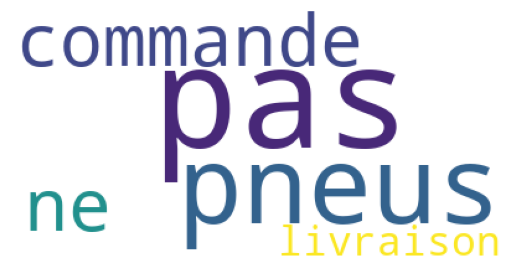

In [12]:
# import sys
# !{sys.executable} -m pip install wordcloud
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

wordcloud = WordCloud(background_color = 'white' , max_words = 40).generate(textCloud)
plt.imshow(wordcloud)
plt.axis("off")
plt.show();

### Data Exploration